In [1]:
!pip install missingno


[notice] A new release of pip is available: 24.0 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
from sklearn import preprocessing
from sklearn.preprocessing import OneHotEncoder
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import skew


In [3]:
copper_data = pd.read_csv("/workspaces/dev/Industrial_Copper_Modelling/Copper_Set.csv")
copper_data.shape

/tmp/ipykernel_2699/1057869904.py:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  copper_data = pd.read_csv("/workspaces/dev/Industrial_Copper_Modelling/Copper_Set.csv")


(181673, 14)

Data Cleaning and Preprocessing

In [4]:
# 'id', 'customer' ---> index values -- cannot contribute to the regression formula
copper_data.drop(columns=["id","customer"],inplace=True)

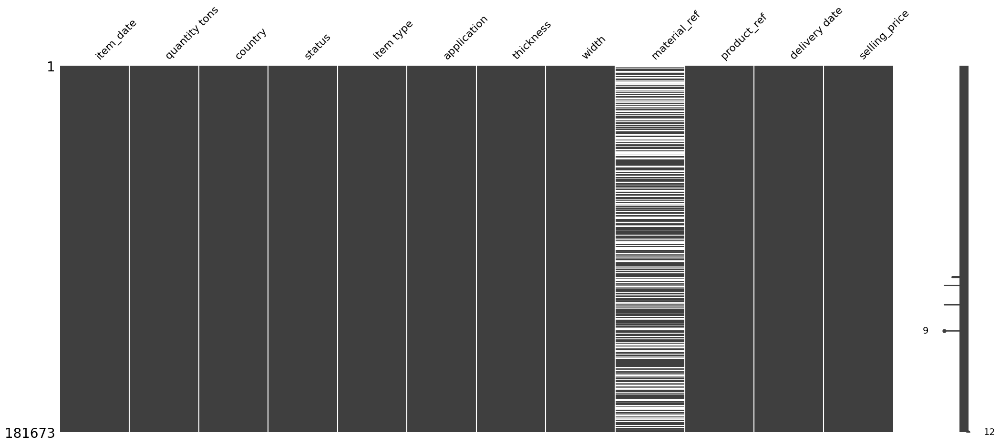

In [5]:
# Visualize the missingness
msno.matrix(copper_data)
plt.show() 

In [6]:
copper_data.isna().sum()

item_date            1
quantity tons        0
country             28
status               2
item type            0
application         24
thickness            1
width                0
material_ref     77919
product_ref          0
delivery date        1
selling_price        1
dtype: int64

In [7]:
copper_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181673 entries, 0 to 181672
Data columns (total 12 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   item_date      181672 non-null  float64
 1   quantity tons  181673 non-null  object 
 2   country        181645 non-null  float64
 3   status         181671 non-null  object 
 4   item type      181673 non-null  object 
 5   application    181649 non-null  float64
 6   thickness      181672 non-null  float64
 7   width          181673 non-null  float64
 8   material_ref   103754 non-null  object 
 9   product_ref    181673 non-null  int64  
 10  delivery date  181672 non-null  float64
 11  selling_price  181672 non-null  float64
dtypes: float64(7), int64(1), object(4)
memory usage: 16.6+ MB


In [8]:
copper_data["quantity tons"] = pd.to_numeric(copper_data["quantity tons"], errors='coerce')

In [9]:
copper_data.describe()

,item_date,quantity tons,country,application,thickness,width,product_ref,delivery date,selling_price
count,1.816720e+05,1.816720e+05,181645.000000,181649.000000,181672.000000,181673.000000,1.816730e+05,1.816720e+05,1.816720e+05
mean,2.020459e+07,5.874926e+03,44.893022,25.615809,2.564827,1295.286724,4.739679e+08,2.020738e+07,1.918036e+03
std,4.551119e+03,2.349081e+06,24.404214,17.754175,6.572321,261.631754,7.175101e+08,2.411059e+04,3.317956e+05
min,1.995000e+07,-2.000000e+03,25.000000,2.000000,0.180000,1.000000,6.117280e+05,2.019040e+07,-1.160000e+03
25%,2.020093e+07,1.097030e+01,26.000000,10.000000,0.700000,1180.000000,6.119930e+05,2.020110e+07,6.690000e+02
50%,2.020113e+07,3.036464e+01,30.000000,15.000000,1.500000,1250.000000,6.406650e+05,2.021010e+07,8.120000e+02
75%,2.021020e+07,6.716061e+01,78.000000,41.000000,3.000000,1500.000000,1.332077e+09,2.021040e+07,9.530000e+02
max,2.021040e+07,1.000000e+09,113.000000,99.000000,2500.000000,2990.000000,1.722208e+09,3.031010e+07,1.000010e+08


In [10]:
# Values of quantity tons and selling_price cannot be negative
# Converting negative values to null
copper_data["quantity tons"] = np.where(copper_data["quantity tons"]<0,np.nan,copper_data["quantity tons"])
copper_data["selling_price"] = np.where(copper_data["selling_price"]<0,np.nan,copper_data["selling_price"])

In [11]:
# Filling missing Column values of country, status with their mode values
copper_data["country"] = copper_data["country"].fillna(copper_data["country"].mode()[0])
copper_data["status"] = copper_data["status"].fillna(copper_data["status"].mode()[0])

In [12]:
# Filling missing Column values of application, thickness, selling price with their mean values
copper_data["quantity tons"] = copper_data["quantity tons"].fillna(copper_data["quantity tons"].mean())
copper_data["application"] = copper_data["application"].fillna(copper_data["application"].mean())
copper_data["thickness"] = copper_data["thickness"].fillna(copper_data["thickness"].mean())
copper_data["selling_price"] = copper_data["selling_price"].fillna(copper_data["selling_price"].mean())

In [13]:
copper_data["material_ref"] = copper_data["material_ref"].fillna("Unknown")

In [14]:
copper_data["material_ref"] = copper_data["material_ref"].apply(lambda x: "Unknown" if x.startswith("00000") else x)

Encoding

In [15]:
copper_data["item type"].unique()

array(['W', 'WI', 'S', 'Others', 'PL', 'IPL', 'SLAWR'], dtype=object)

In [16]:
# Encoding Categorical Data Columns using OneHot Encoder
categorical_columns = ['item type']
# Initialize OneHotEncoder
encoder = OneHotEncoder(sparse_output=False)
# Fit and transform categorical columns
encoded_categories = encoder.fit_transform(copper_data[categorical_columns])
# Convert the encoded array to a DataFrame
encoded_df = pd.DataFrame(encoded_categories, columns=encoder.get_feature_names_out(categorical_columns))

In [17]:
encoded_df.shape

(181673, 7)

In [18]:
copper_data.drop(columns=["item type"],inplace=True)

In [19]:
# Combine the Dataframes
combined_df = pd.concat([encoded_df,copper_data],axis=1)

In [20]:
combined_df

,item type_IPL,item type_Others,item type_PL,item type_S,item type_SLAWR,item type_W,item type_WI,item_date,quantity tons,country,status,application,thickness,width,material_ref,product_ref,delivery date,selling_price
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20210401.0,54.151139,28.0,Won,10.0,2.00,1500.0,DEQ1 S460MC,1670798778,20210701.0,854.00
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20210401.0,768.024839,25.0,Won,41.0,0.80,1210.0,Unknown,1668701718,20210401.0,1047.00
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,20210401.0,386.127949,30.0,Won,28.0,0.38,952.0,S0380700,628377,20210101.0,644.33
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,20210401.0,202.411065,32.0,Won,59.0,2.30,1317.0,DX51D+ZM310MAO 2.3X1317,1668701718,20210101.0,768.00
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20210401.0,785.526262,28.0,Won,10.0,4.00,2000.0,2_S275JR+AR-CL1,640665,20210301.0,577.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181668,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20200702.0,102.482422,25.0,Won,41.0,0.96,1220.0,Unknown,164141591,20200701.0,591.00
181669,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20200702.0,208.086469,25.0,Won,41.0,0.95,1500.0,Unknown,164141591,20200701.0,589.00
181670,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20200702.0,4.235594,25.0,Won,41.0,0.71,1250.0,Unknown,164141591,20200701.0,619.00
181671,0.0,0.0,0.0,0.0,0.0,1.0,0.0,20200702.0,5875.066247,25.0,Won,41.0,0.85,1250.0,Unknown,164141591,20200701.0,601.00


In [21]:
# Frequency Encoding - Categorical Data columns with high number of categories 
mat_ref_freq = combined_df["material_ref"].value_counts().to_dict()
# Categorical value replaced with frequency of occurence of each category
combined_df["material_ref"] = combined_df["material_ref"].map(mat_ref_freq)

In [22]:
combined_df["material_ref"].value_counts()

material_ref
100645    100645
4           5504
3           3735
2           3626
5           3600
           ...  
72            72
68            68
67            67
51            51
47            47
Name: count, Length: 143, dtype: int64

Handling Date Columns

In [23]:
# Function to handle conversion with validation
def convert_to_date(float_date):
    try:
        # Convert float to integer, then to string
        date_str = str(int(float_date))
        # Check if length is correct (8 digits)
        if len(date_str) == 8:
            # Convert string to datetime
            return pd.to_datetime(date_str, format='%Y%m%d', errors='coerce')
        else:
            # Return NaT for invalid formats
            return pd.NaT
    except Exception as e:
        return pd.NaT

# Apply conversion
combined_df["item_date"] = combined_df["item_date"].apply(convert_to_date)
combined_df["delivery date"] = combined_df["delivery date"].apply(convert_to_date)

In [24]:
combined_df[combined_df["item_date"].isnull()]
combined_df[combined_df["delivery date"].isnull()]

,item type_IPL,item type_Others,item type_PL,item type_S,item type_SLAWR,item type_W,item type_WI,item_date,quantity tons,country,status,application,thickness,width,material_ref,product_ref,delivery date,selling_price
58,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,13.634770,28.0,To be approved,10.0,0.6,1250.0,100645,611993,NaT,1266.0
104761,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2020-11-12,100.229137,26.0,Won,10.0,1.0,1300.0,100645,611993,NaT,1005.0
105421,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2020-11-12,30.714021,28.0,Won,70.0,0.6,1250.0,100645,611993,NaT,825.0


In [25]:
# Only 3 rows each of item_date and delivery date contains NaT values - so dropping those 6 rows
combined_df.dropna(subset=['item_date','delivery date'], inplace=True)

In [26]:
combined_df.isna().sum()

item type_IPL       0
item type_Others    0
item type_PL        0
item type_S         0
item type_SLAWR     0
item type_W         0
item type_WI        0
item_date           0
quantity tons       0
country             0
status              0
application         0
thickness           0
width               0
material_ref        0
product_ref         0
delivery date       0
selling_price       0
dtype: int64

In [27]:
combined_df.shape

(181667, 18)

Handling Outliers

In [28]:
# Finding Outliers
px.box(combined_df["quantity tons"])

In [29]:
# Treating rows with outliers 
Q1 = combined_df["quantity tons"].quantile(0.25)
Q3 = combined_df["quantity tons"].quantile(0.75)
IQR = Q3 - Q1     

#Finding upper and lower limit
Upper_limit = Q3 + 1.5 * IQR
Lower_limit = Q1 - 1.5 * IQR

#Capping
combined_df["quantity tons"] = np.where(combined_df["quantity tons"]>Upper_limit,Upper_limit,combined_df["quantity tons"])
combined_df["quantity tons"] = np.where(combined_df["quantity tons"]<Lower_limit,Lower_limit,combined_df["quantity tons"])

In [30]:
px.box(combined_df["thickness"])

In [31]:
# Treating rows with outliers 
q1 = combined_df["thickness"].quantile(0.25)
q3 = combined_df["thickness"].quantile(0.75)
iqr = q3 - q1     

#Finding upper and lower limit
upper_limit = q3 + (1.5 * iqr)
lower_limit = q1 - (1.5 * iqr)
#Capping
combined_df["thickness"] = np.where(combined_df["thickness"]>upper_limit,upper_limit,combined_df["thickness"])
combined_df["thickness"] = np.where(combined_df["thickness"]<lower_limit,lower_limit,combined_df["thickness"])


In [32]:
combined_df.describe()

,item type_IPL,item type_Others,item type_PL,item type_S,item type_SLAWR,item type_W,item type_WI,item_date,quantity tons,country,application,thickness,width,material_ref,product_ref,delivery date,selling_price
count,181667.000000,181667.000000,181667.000000,181667.000000,181667.000000,181667.000000,181667.000000,181667,181667.000000,181667.000000,181667.000000,181667.000000,181667.000000,181667.000000,1.816670e+05,181667,1.816670e+05
mean,0.000149,0.003358,0.031156,0.381087,0.000006,0.581360,0.002884,2020-11-26 22:56:12.883352832,49.180948,44.898149,25.615851,2.245467,1295.285308,55795.307348,4.739735e+08,2021-01-25 22:43:35.259788544,1.918136e+03
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2020-07-02 00:00:00,0.000010,25.000000,2.000000,0.180000,1.000000,1.000000,6.117280e+05,2019-04-01 00:00:00,0.000000e+00
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2020-09-29 00:00:00,10.971048,26.000000,10.000000,0.700000,1180.000000,21.000000,6.119930e+05,2020-11-01 00:00:00,6.690000e+02
50%,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,2020-11-30 00:00:00,30.365363,30.000000,15.000000,1.500000,1250.000000,100645.000000,6.406650e+05,2021-01-01 00:00:00,8.120000e+02
75%,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,2021-02-03 00:00:00,67.167570,78.000000,41.000000,3.000000,1500.000000,100645.000000,1.332077e+09,2021-04-01 00:00:00,9.530000e+02
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2021-04-01 00:00:00,151.462354,113.000000,99.000000,6.450000,2990.000000,100645.000000,1.722208e+09,2022-01-01 00:00:00,1.000010e+08
std,0.012190,0.057849,0.173739,0.485655,0.002346,0.493337,0.053629,NaN,47.999852,24.405797,17.752762,1.890722,261.635410,49984.170171,7.175126e+08,NaN,3.318002e+05


Handling Skewness

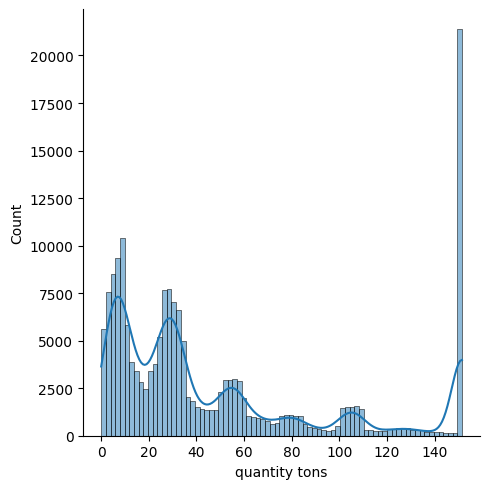

In [33]:
sns.displot(combined_df["quantity tons"],kde=True)
plt.show()

In [34]:
# Calculate skewness
original_skewness = skew(combined_df["quantity tons"])
print(f'Original Skewness: {original_skewness}')

Original Skewness: 1.1218011447088534


In [35]:
# Log transformation
# Without constant - transformed values result negative min values - so added 12 to 
combined_df["quantity tons"] = np.log(combined_df["quantity tons"]+12)

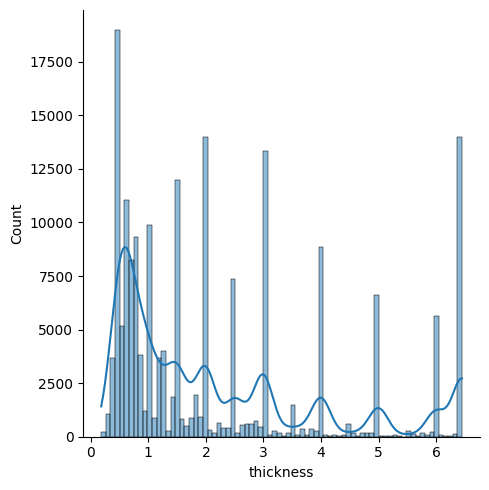

In [36]:
sns.displot(combined_df["thickness"],kde=True)
plt.show()

In [37]:
# Calculate skewness
original_skewness = skew(combined_df["thickness"])
print(f'Original Skewness: {original_skewness}')

Original Skewness: 1.0608920063862473


In [38]:
# Log transformation
combined_df["thickness"] = np.log(combined_df["thickness"]+1)

In [39]:
combined_df["date_differ"] = (combined_df["delivery date"] - combined_df["item_date"]).dt.days

Handling wrong Delivery Dates with Random Forest Regressor Prediction

In [61]:
datePred_df = combined_df.copy()

In [63]:
datePred_df["item_date_num"] = datePred_df["item_date"].astype(str)
datePred_df["item_date_num"] = datePred_df["item_date_num"].str.replace('-', '', regex=False).astype(int)

In [ ]:
datePred_df.drop(columns=["item_date","delivery date"],inplace=True)

In [42]:
datePred_df["status"].unique()

array(['Won', 'Draft', 'To be approved', 'Lost', 'Not lost for AM',
       'Wonderful', 'Revised', 'Offered', 'Offerable'], dtype=object)

In [43]:
datePred_df["status"] = datePred_df["status"].map({'Won':8,'Draft':1,"To be approved":4,"Lost":0,"Not lost for AM":6, "Wonderful":7,"Revised":2,"Offered":5,"Offerable":3})

In [44]:
datePred_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 181667 entries, 0 to 181672
Data columns (total 20 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   item type_IPL     181667 non-null  float64       
 1   item type_Others  181667 non-null  float64       
 2   item type_PL      181667 non-null  float64       
 3   item type_S       181667 non-null  float64       
 4   item type_SLAWR   181667 non-null  float64       
 5   item type_W       181667 non-null  float64       
 6   item type_WI      181667 non-null  float64       
 7   item_date         181667 non-null  datetime64[ns]
 8   quantity tons     181667 non-null  float64       
 9   country           181667 non-null  float64       
 10  status            181667 non-null  int64         
 11  application       181667 non-null  float64       
 12  thickness         181667 non-null  float64       
 13  width             181667 non-null  float64       
 14  material_

In [45]:
datePred_df

,item type_IPL,item type_Others,item type_PL,item type_S,item type_SLAWR,item type_W,item type_WI,item_date,quantity tons,country,status,application,thickness,width,material_ref,product_ref,delivery date,selling_price,date_differ,item_date_num
0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,4.191942,28.0,8,10.0,1.098612,1500.0,8,1670798778,2021-07-01,854.00,91,20210401
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,5.096583,25.0,8,41.0,0.587787,1210.0,100645,1668701718,2021-04-01,1047.00,0,20210401
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2021-04-01,5.096583,30.0,8,28.0,0.322083,952.0,3,628377,2021-01-01,644.33,-90,20210401
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2021-04-01,5.096583,32.0,8,59.0,1.193922,1317.0,9,1668701718,2021-01-01,768.00,-90,20210401
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,5.096583,28.0,8,10.0,1.609438,2000.0,21,640665,2021-03-01,577.00,-31,20210401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181668,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,4.740421,25.0,8,41.0,0.672944,1220.0,100645,164141591,2020-07-01,591.00,-1,20200702
181669,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,5.096583,25.0,8,41.0,0.667829,1500.0,100645,164141591,2020-07-01,589.00,-1,20200702
181670,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,2.787206,25.0,8,41.0,0.536493,1250.0,100645,164141591,2020-07-01,619.00,-1,20200702
181671,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,5.096583,25.0,8,41.0,0.615186,1250.0,100645,164141591,2020-07-01,601.00,-1,20200702


In [46]:
# Random Forest Regressor - to predict the correct values for those negative value rows in date differ
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import r2_score
train = datePred_df[(datePred_df["date_differ"]>0) | (datePred_df["date_differ"]==0)]
test = datePred_df[datePred_df["date_differ"]<0]
yd_train = train["date_differ"]
xd_train = train.drop(columns=["date_differ"])
xd_test = test.drop(columns=["date_differ"])

/tmp/ipykernel_2699/2077532600.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_2699/2077532600.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [47]:
model = RandomForestRegressor().fit(xd_train,yd_train)

In [48]:
yd_pred = model.predict(xd_test)

In [49]:
yd_pred

array([ 13.9 , 168.64,  46.5 , ...,  39.51,  40.8 ,  40.49])

In [50]:
test.loc[:,"date_differ"] = yd_pred
test["date_differ"] = test["date_differ"].astype(int)

/tmp/ipykernel_2699/2075307638.py:1: FutureWarning:

Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ 13.9  168.64  46.5  ...  39.51  40.8   40.49]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.

/tmp/ipykernel_2699/2075307638.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [57]:
test["item_date"] = test["item_date_num"].apply(convert_to_date)

/tmp/ipykernel_2699/3051165235.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [59]:
test["delivery date"] = test["item_date"] + pd.to_timedelta(test["date_differ"],unit= "D")

/tmp/ipykernel_2699/3022779108.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [62]:
test.drop(columns="item_date_num",inplace=True)

SyntaxError: invalid syntax (560360726.py, line 1)

In [51]:
test.shape

(16107, 18)

In [60]:
test.tail(2)

,item type_IPL,item type_Others,item type_PL,item type_S,item type_SLAWR,item type_W,item type_WI,quantity tons,country,status,application,thickness,width,material_ref,product_ref,selling_price,date_differ,item_date_num,item_date,delivery date
181671,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.096583,25.0,8,41.0,0.615186,1250.0,100645,164141591,601.0,40,20200702,2020-07-02,2020-08-11
181672,0.0,0.0,0.0,0.0,0.0,1.0,0.0,5.096583,25.0,8,41.0,0.536493,1240.0,100645,164141591,607.0,40,20200702,2020-07-02,2020-08-11


In [53]:
combined_df[combined_df["date_differ"]<0]

,item type_IPL,item type_Others,item type_PL,item type_S,item type_SLAWR,item type_W,item type_WI,item_date,quantity tons,country,status,application,thickness,width,material_ref,product_ref,delivery date,selling_price,date_differ
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,2021-04-01,5.096583,30.0,Won,28.0,0.322083,952.0,3,628377,2021-01-01,644.33,-90
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,2021-04-01,5.096583,32.0,Won,59.0,1.193922,1317.0,9,1668701718,2021-01-01,768.00,-90
4,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,5.096583,28.0,Won,10.0,1.609438,2000.0,21,640665,2021-03-01,577.00,-31
7,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,4.831406,32.0,Won,41.0,0.518794,1220.0,100645,611993,2021-01-01,931.00,-90
11,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2021-04-01,4.836248,32.0,Won,41.0,0.438255,1220.0,100645,611993,2021-01-01,954.00,-90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181668,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,4.740421,25.0,Won,41.0,0.672944,1220.0,100645,164141591,2020-07-01,591.00,-1
181669,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,5.096583,25.0,Won,41.0,0.667829,1500.0,100645,164141591,2020-07-01,589.00,-1
181670,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,2.787206,25.0,Won,41.0,0.536493,1250.0,100645,164141591,2020-07-01,619.00,-1
181671,0.0,0.0,0.0,0.0,0.0,1.0,0.0,2020-07-02,5.096583,25.0,Won,41.0,0.615186,1250.0,100645,164141591,2020-07-01,601.00,-1
